In [4]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [5]:
import numpy as np
import scanpy as sc
import time
from pathlib import Path
import torch
import Concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [6]:
proj_name = "concord_treg"
save_dir = f"/wynton/home/gartner/zhuqin/Concord/save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
seed = 0
ccd.ul.set_seed(seed)

In [7]:
data_path = "/wynton/home/gartner/zhuqin/Concord/data/treg_data/R_treg_graph_ad.h5ad"
adata = sc.read(
    data_path
)
adata.obs['T_subtype_refined']=adata.obs['T_subtype_refined'].cat.remove_unused_categories()


FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = 'data/treg_data/R_treg_graph_ad.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [5]:
feature_list = ccd.ul.select_features(adata, n_top_features=3000, flavor='seurat_v3')

Concord.utils.feature_selector - INFO - Selecting highly variable features with flavor seurat_v3...


In [7]:
params = {
    "project_name": proj_name,
    "input_feature": feature_list,
    "batch_size": 64,
    "n_epochs": 5,
    "lr": 1e-3,
    "latent_dim": 32,
    "encoder_dims": [256],
    "decoder_dims": [256],
    "augmentation_mask_prob": 0.5,
    "dropout_prob": 0.1,
    "use_decoder": True,
    "decoder_weight": 1.0,
    "use_classifier": False,
    "classifier_weight": 1.0,
    "clr_temperature":0.5,
    "domain_embedding_dim":8,
    "use_importance_mask": True,
    "importance_penalty_type": 'L1',
    "importance_penalty_weight": 0,
    "domain_key": 'dataset.ident',
    "class_key": None,
    "sampler_emb": "X_pca",
    "sampler_knn": 128,
    "p_intra_knn": 0.5,
    "p_intra_domain": None,
    "min_p_intra_domain": 0.9,
    "pca_n_comps": 50,
    "use_faiss": True,
    "use_ivf": True,
    "ivf_nprobe": 10,
    "inplace": False,
    "save_dir": save_dir,
    "device": device,
    "verbose": True
}
output_key = "Concord"
file_suffix = f"{time.strftime('%b%d-%H%M')}"

In [8]:
# Single run
cur_ccd = ccd.Concord(adata=adata, **params)
cur_ccd.encode_adata(input_layer_key="X_log1p", output_key=output_key)
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, obsm_filename)
adata.obsm[output_key] = cur_ccd.adata.obsm[output_key] # If not inplace

Concord - INFO - Column 'dataset.ident' is already of type: category
Concord - INFO - Unused levels dropped for column 'dataset.ident'.
Concord - INFO - Encoder input dim: 3000
Concord - INFO - Decoder input dim: 40
Concord - INFO - Total number of parameters: 1562096
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord.model.dataloader - INFO - PCA completed.
Concord.model.knn - INFO - Using FAISS GPU index.
Concord.model.knn - INFO - Building Faiss IVF index. nprobe=10
Concord.model.dataloader - INFO - Number of unique_domains: 4
Concord.model.dataloader - I

Epoch 0 Training: 461it [00:14, 32.01it/s, loss=4.14]

Concord - INFO - Epoch   0 | Train Loss: 4.41, MSE: 0.17, CLASS: 0.00, CONTRAST: 4.23, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 2/5
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 29584


Epoch 1 Training: 100%|██████████| 461/461 [00:10<00:00, 45.91it/s, loss=4.09]

Concord - INFO - Epoch   1 | Train Loss: 4.07, MSE: 0.13, CLASS: 0.00, CONTRAST: 3.94, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/5
Concord - INFO - Processing chunk 1/1 for epoch 3


Concord - INFO - Number of samples in train_dataloader: 29584


Epoch 2 Training: 100%|██████████| 461/461 [00:09<00:00, 49.35it/s, loss=3.81]

Concord - INFO - Epoch   2 | Train Loss: 3.96, MSE: 0.12, CLASS: 0.00, CONTRAST: 3.84, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/5
Concord - INFO - Processing chunk 1/1 for epoch 4


Concord - INFO - Number of samples in train_dataloader: 29584


Epoch 3 Training: 100%|██████████| 461/461 [00:08<00:00, 51.57it/s, loss=3.93]

Concord - INFO - Epoch   3 | Train Loss: 3.93, MSE: 0.12, CLASS: 0.00, CONTRAST: 3.81, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/5
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 29584



Epoch 4 Training: 100%|██████████| 461/461 [00:09<00:00, 47.22it/s, loss=3.77]

Concord - INFO - Epoch   4 | Train Loss: 3.91, MSE: 0.12, CLASS: 0.00, CONTRAST: 3.79, IMPORTANCE: 0.00


Concord - INFO - Model saved to save/dev_concord_treg-Sep20/final_model.pth
Concord - INFO - Final model saved at: save/dev_concord_treg-Sep20/final_model.pth; Configuration saved at: save/dev_concord_treg-Sep20/config.json.
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1


Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


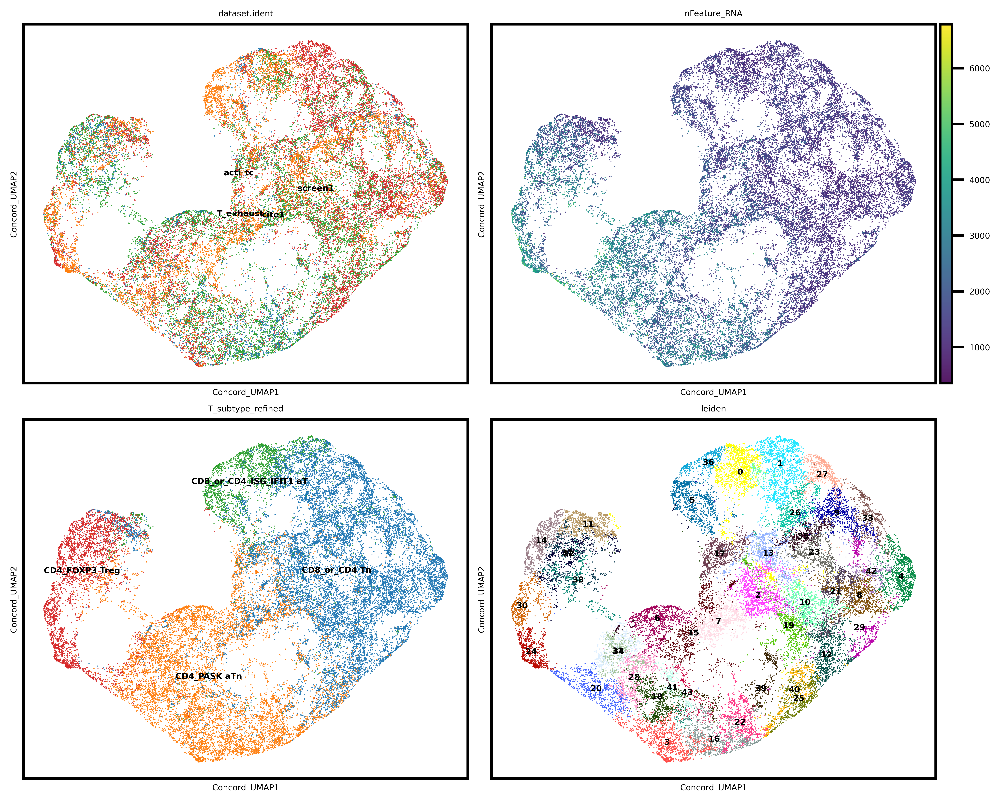

In [10]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=seed, use_cuml=False)
sc.pp.neighbors(adata, use_rep="Concord")
sc.tl.leiden(adata, resolution=2.0)
show_cols = ['dataset.ident', 'nFeature_RNA', 'T_subtype_refined', 'leiden']
show_emb = 'Concord_UMAP'

ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(10,8), dpi=600, ncols=2, font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)

### Enhance with Concord-ant + Leiden

In [11]:
params = {
    "project_name": proj_name,
    "input_feature": feature_list,
    "batch_size": 64,
    "n_epochs": 5,
    "lr": 1e-3,
    "train_frac": 0.8,
    "latent_dim": 32,
    "encoder_dims": [256],
    "decoder_dims": [256],
    "augmentation_mask_prob": 0.5,
    "dropout_prob": 0.1,
    "use_decoder": True,
    "decoder_weight": 1.0,
    "use_classifier": True,
    "classifier_weight": 1.0,
    "clr_temperature":0.5,
    "domain_embedding_dim":8,
    "use_importance_mask": True,
    "importance_penalty_type": 'L1',
    "importance_penalty_weight": 0,
    "domain_key": 'dataset.ident',
    "class_key": "T_subtype_refined",
    "sampler_emb": "X_pca",
    "sampler_knn": 128,
    "p_intra_knn": 0.5,
    "p_intra_domain": None,
    "min_p_intra_domain": 0.9,
    "pca_n_comps": 50,
    "use_faiss": True,
    "use_ivf": True,
    "ivf_nprobe": 10,
    "inplace": False,
    "save_dir": save_dir,
    "device": device,
    "verbose": True
}
output_key = 'Concordant_class'
cur_ccd = ccd.Concord(adata=adata, **params)
cur_ccd.encode_adata(input_layer_key="X_log1p", output_key=output_key)
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, obsm_filename)
adata.obsm[output_key] = cur_ccd.adata.obsm[output_key] # If not inplace

Concord - INFO - Column 'dataset.ident' is already of type: category
Concord - INFO - Unused levels dropped for column 'dataset.ident'.
Concord - INFO - Column 'T_subtype_refined' is already of type: category
Concord - INFO - Unused levels dropped for column 'T_subtype_refined'.
Concord - INFO - Encoder input dim: 3000
Concord - INFO - Decoder input dim: 40
Concord - INFO - Classifier input dim: 32
Concord - INFO - Total number of parameters: 1563348
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord.model.dataloader - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord.model.dataloader - INFO - PCA completed.
Concord.

Epoch 0 Training: 461it [00:13, 35.23it/s, loss=4.79]

Concord - INFO - Epoch   0 | Train Loss: 4.76, MSE: 0.17, CLASS: 0.50, CONTRAST: 4.09, IMPORTANCE: 0.00


Concord - INFO - Epoch:   0 | Train accuracy:  0.82 | precision: 0: 0.83, 1: 0.82, 2: 0.67, 3: 0.79 | recall: 0: 0.91, 1: 0.81, 2: 0.43, 3: 0.67 | f1: 0: 0.87, 1: 0.82, 2: 0.53, 3: 0.73


Epoch 0 Validation: 460it [00:03, 136.22it/s, loss=2.28]

Concord - INFO - Epoch   0 | Val Loss: 2.56, MSE: 0.13, CLASS: 0.31, CONTRAST: 2.13, IMPORTANCE: 0.00


Concord - INFO - Epoch:   0 | Val accuracy:  0.88 | precision: 0: 0.93, 1: 0.85, 2: 0.73, 3: 0.89 | recall: 0: 0.88, 1: 0.94, 2: 0.74, 3: 0.83 | f1: 0: 0.90, 1: 0.89, 2: 0.73, 3: 0.86
Concord - INFO - New best model found at epoch 1 with validation loss: 2.5636
Concord - INFO - Starting epoch 2/5
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 1 Training: 100%|██████████| 461/461 [00:10<00:00, 43.98it/s, loss=4.42]

Concord - INFO - Epoch   1 | Train Loss: 4.34, MSE: 0.13, CLASS: 0.35, CONTRAST: 3.85, IMPORTANCE: 0.00


Concord - INFO - Epoch:   1 | Train accuracy:  0.87 | precision: 0: 0.89, 1: 0.87, 2: 0.76, 3: 0.85 | recall: 0: 0.92, 1: 0.86, 2: 0.66, 3: 0.82 | f1: 0: 0.90, 1: 0.87, 2: 0.71, 3: 0.84


Epoch 1 Validation: 100%|██████████| 461/461 [00:03<00:00, 136.43it/s, loss=2.55]

Concord - INFO - Epoch   1 | Val Loss: 2.35, MSE: 0.12, CLASS: 0.25, CONTRAST: 1.97, IMPORTANCE: 0.00


Concord - INFO - Epoch:   1 | Val accuracy:  0.90 | precision: 0: 0.92, 1: 0.88, 2: 0.81, 3: 0.93 | recall: 0: 0.92, 1: 0.93, 2: 0.70, 3: 0.86 | f1: 0: 0.92, 1: 0.91, 2: 0.75, 3: 0.89
Concord - INFO - New best model found at epoch 2 with validation loss: 2.3450
Concord - INFO - Starting epoch 3/5
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 2 Training: 100%|██████████| 461/461 [00:08<00:00, 53.66it/s, loss=4]   

Concord - INFO - Epoch   2 | Train Loss: 4.18, MSE: 0.13, CLASS: 0.31, CONTRAST: 3.74, IMPORTANCE: 0.00


Concord - INFO - Epoch:   2 | Train accuracy:  0.88 | precision: 0: 0.90, 1: 0.89, 2: 0.77, 3: 0.87 | recall: 0: 0.93, 1: 0.88, 2: 0.67, 3: 0.84 | f1: 0: 0.91, 1: 0.89, 2: 0.72, 3: 0.86


Epoch 2 Validation: 100%|██████████| 461/461 [00:03<00:00, 145.54it/s, loss=2.83] 

Concord - INFO - Epoch   2 | Val Loss: 2.16, MSE: 0.12, CLASS: 0.24, CONTRAST: 1.80, IMPORTANCE: 0.00


Concord - INFO - Epoch:   2 | Val accuracy:  0.90 | precision: 0: 0.94, 1: 0.88, 2: 0.84, 3: 0.86 | recall: 0: 0.91, 1: 0.93, 2: 0.71, 3: 0.92 | f1: 0: 0.92, 1: 0.91, 2: 0.77, 3: 0.89
Concord - INFO - New best model found at epoch 3 with validation loss: 2.1618
Concord - INFO - Starting epoch 4/5
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 3 Training: 100%|██████████| 461/461 [00:10<00:00, 44.44it/s, loss=4.08]

Concord - INFO - Epoch   3 | Train Loss: 4.10, MSE: 0.12, CLASS: 0.32, CONTRAST: 3.66, IMPORTANCE: 0.00


Concord - INFO - Epoch:   3 | Train accuracy:  0.88 | precision: 0: 0.90, 1: 0.89, 2: 0.77, 3: 0.87 | recall: 0: 0.93, 1: 0.88, 2: 0.66, 3: 0.86 | f1: 0: 0.91, 1: 0.88, 2: 0.71, 3: 0.86


Epoch 3 Validation: 100%|█████████▉| 460/461 [00:03<00:00, 143.39it/s, loss=1.7] 

Concord - INFO - Epoch   3 | Val Loss: 2.13, MSE: 0.12, CLASS: 0.25, CONTRAST: 1.75, IMPORTANCE: 0.00


Concord - INFO - Epoch:   3 | Val accuracy:  0.91 | precision: 0: 0.94, 1: 0.88, 2: 0.89, 3: 0.85 | recall: 0: 0.91, 1: 0.95, 2: 0.71, 3: 0.92 | f1: 0: 0.93, 1: 0.91, 2: 0.79, 3: 0.88
Concord - INFO - New best model found at epoch 4 with validation loss: 2.1264
Concord - INFO - Starting epoch 5/5
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 4 Training: 100%|██████████| 461/461 [00:08<00:00, 56.84it/s, loss=4.08]

Concord - INFO - Epoch   4 | Train Loss: 4.05, MSE: 0.12, CLASS: 0.30, CONTRAST: 3.62, IMPORTANCE: 0.00


Concord - INFO - Epoch:   4 | Train accuracy:  0.89 | precision: 0: 0.90, 1: 0.89, 2: 0.78, 3: 0.87 | recall: 0: 0.93, 1: 0.88, 2: 0.67, 3: 0.85 | f1: 0: 0.92, 1: 0.89, 2: 0.72, 3: 0.86


Epoch 4 Validation: 100%|██████████| 461/461 [00:03<00:00, 143.74it/s, loss=2.47]

Concord - INFO - Epoch   4 | Val Loss: 2.15, MSE: 0.12, CLASS: 0.30, CONTRAST: 1.74, IMPORTANCE: 0.00


Concord - INFO - Epoch:   4 | Val accuracy:  0.88 | precision: 0: 0.94, 1: 0.85, 2: 0.72, 3: 0.84 | recall: 0: 0.86, 1: 0.94, 2: 0.75, 3: 0.91 | f1: 0: 0.90, 1: 0.89, 2: 0.73, 3: 0.88
Concord - INFO - No improvement in validation loss for 1 epoch(s).
Concord - INFO - Best model state loaded into the model before final save.
Concord - INFO - Model saved to save/dev_concord_treg-Sep20/final_model.pth
Concord - INFO - Final model saved at: save/dev_concord_treg-Sep20/final_model.pth; Configuration saved at: save/dev_concord_treg-Sep20/config.json.
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord - INFO - Predicting for chunk 1/1


Concord - INFO - UMAP embedding stored in adata.obsm['Concordant_class_UMAP']


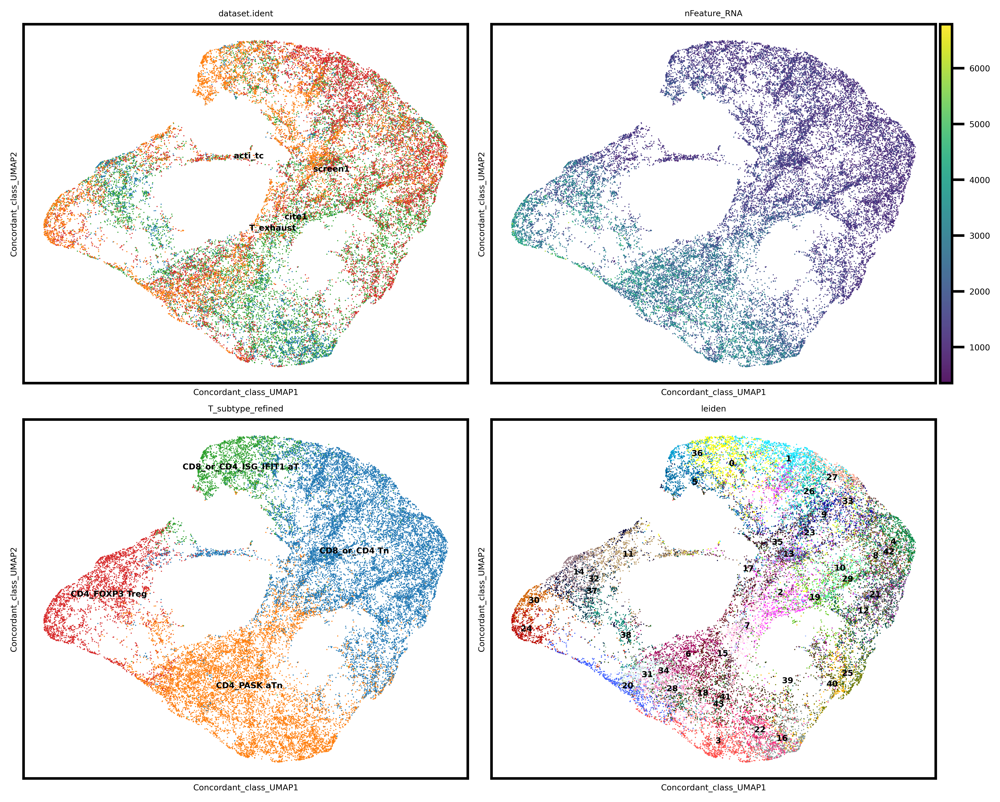

In [12]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=seed, use_cuml=False)
show_cols = ['dataset.ident', 'nFeature_RNA', 'T_subtype_refined', 'leiden']
show_emb = f'{output_key}_UMAP'

ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(10,8), dpi=600, ncols=2, font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)


### Enhancing with 1nn contrastive loss

In [13]:
output_key = "Concord-1nn"
params['sampler_emb'] = "Concord"
params['use_classifier'] = False
params['train_frac'] = 1.0
params['clr_mode'] = 'nn'
params['n_epochs'] = 3
cur_ccd = ccd.Concord(adata=adata, **params)
cur_ccd.encode_adata(input_layer_key="X_log1p", output_key=output_key)
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, obsm_filename)
adata.obsm[output_key] = cur_ccd.adata.obsm[output_key] # If not inplace

Concord - INFO - Column 'dataset.ident' is already of type: category
Concord - INFO - Unused levels dropped for column 'dataset.ident'.
Concord - INFO - Column 'T_subtype_refined' is already of type: category
Concord - INFO - Unused levels dropped for column 'T_subtype_refined'.
Concord - INFO - Encoder input dim: 3000
Concord - INFO - Decoder input dim: 40
Concord - INFO - Total number of parameters: 1562096
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'Concord' from adata.obsm
Concord.model.knn - INFO - Using FAISS GPU index.
Concord.model.knn - INFO - Building Faiss IVF index.

Epoch 0 Training: 923it [00:17, 51.47it/s, loss=3.63]

Concord - INFO - Epoch   0 | Train Loss: 3.83, MSE: 0.15, CLASS: 0.00, CONTRAST: 3.69, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 2/3
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 29584


Epoch 1 Training: 100%|██████████| 923/923 [00:18<00:00, 49.46it/s, loss=3.37]

Concord - INFO - Epoch   1 | Train Loss: 3.58, MSE: 0.12, CLASS: 0.00, CONTRAST: 3.45, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 3/3
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 29584


Epoch 2 Training: 100%|██████████| 923/923 [00:18<00:00, 50.86it/s, loss=3.42]

Concord - INFO - Epoch   2 | Train Loss: 3.52, MSE: 0.12, CLASS: 0.00, CONTRAST: 3.40, IMPORTANCE: 0.00


Concord - INFO - Model saved to save/dev_concord_treg-Sep20/final_model.pth
Concord - INFO - Final model saved at: save/dev_concord_treg-Sep20/final_model.pth; Configuration saved at: save/dev_concord_treg-Sep20/config.json.
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord - INFO - Predicting for chunk 1/1


Concord - INFO - UMAP embedding stored in adata.obsm['Concord-1nn_UMAP']


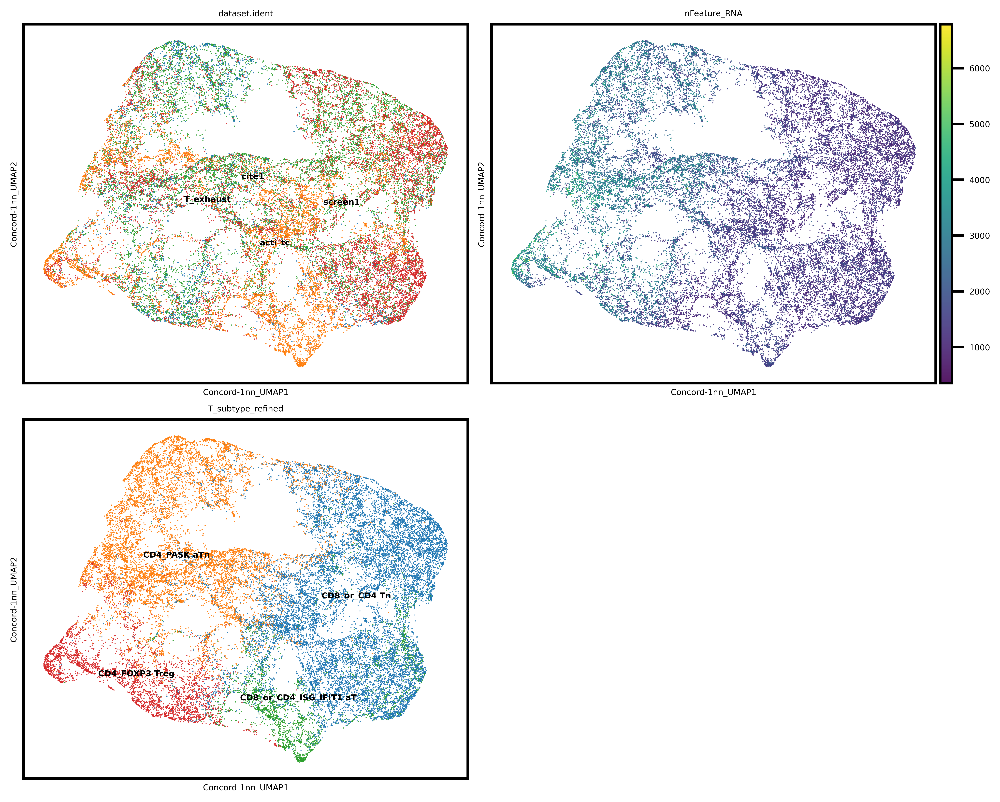

In [14]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=seed, use_cuml=False)

show_cols = ['dataset.ident', 'nFeature_RNA', 'T_subtype_refined']
adata.obs['T_subtype_refined'] = adata.obs['T_subtype_refined'].cat.remove_unused_categories()
#sc.pp.neighbors(adata, use_rep=f'{output_key}_UMAP')
#sc.tl.leiden(adata, resolution=0.2)
show_emb = f'{output_key}_UMAP'

ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(10,8), dpi=600, ncols=2, font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)


loaded 29584 cells and 17 genes


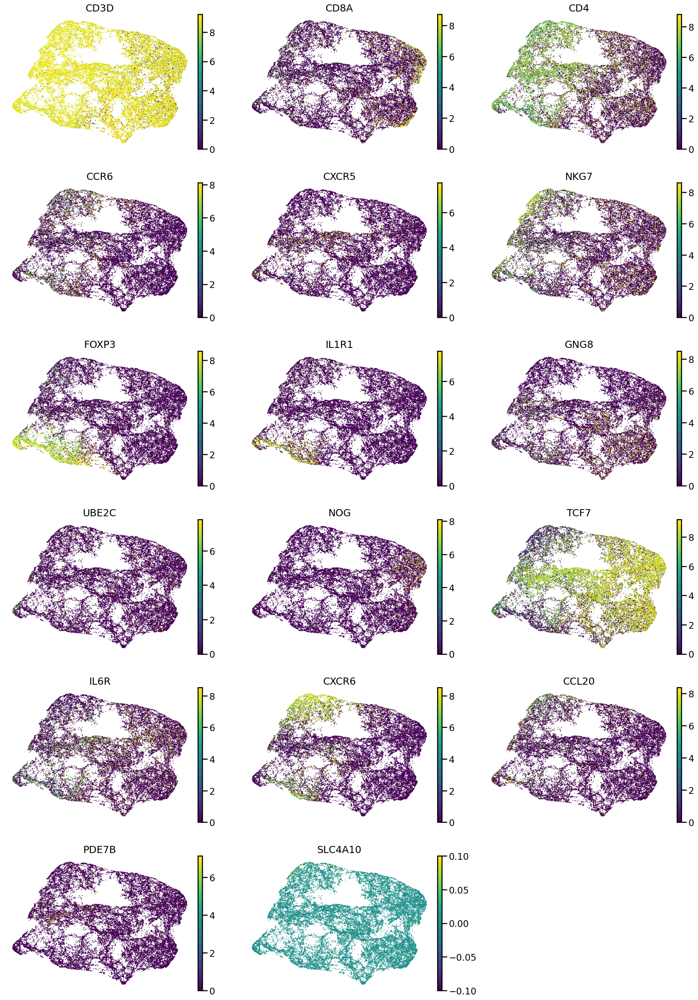

In [15]:
import matplotlib.pyplot as plt
genes_to_load = ["CD3D", "CD8A", "CD4", "CCR6", "CXCR5", "NKG7", "FOXP3", "IL1R1", "GNG8", "UBE2C", 
                 "NOG", "TCF7", "IL6R", "CXCR6","CCL20", "PDE7B", "SLC4A10"]
adata_sub = adata[:, genes_to_load].to_memory()
sc.pp.normalize_total(adata_sub, target_sum=1e4)
sc.pp.log1p(adata_sub)
print(f"loaded {adata_sub.shape[0]} cells and {adata_sub.shape[1]} genes")
# Calculate the 97.5% quantile for each gene
vmax_values = {}
for gene in genes_to_load:
    vmax_values[gene] = np.quantile(adata_sub[:, gene].X.toarray(), 0.995)
show_emb = f'{output_key}_UMAP'
# Plot the gene expression
sc.pl.embedding(
    adata_sub,
    basis=show_emb,
    color=genes_to_load,
    legend_loc='on data',
    frameon=False,
    ncols=3,
    size=8,
    vmax=list(vmax_values.values()),
    cmap='viridis',
    show=False
)
plt.savefig(save_dir / f"gexpr_{show_emb}_{file_suffix}.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()


In [18]:
from Concord.utils.visCello import anndata_to_viscello
anndata_to_viscello(adata, save_dir / f"cello_{proj_name}_adata_{file_suffix}", project_name = proj_name, organism='hsa')

Concord - INFO - Normalized expression data (adata.layers['X_log1p']) not found. Renormalize and log transforming.
VisCello project created at save/dev_concord_treg-Sep20/cello_concord_treg_adata_Sep20-1945
